# Exploring the public AWS COVID-19 Data Lake
## Introduction Notebook


Use cases for COVID-19 data will vary depending on the role of the responder. This notebook demonstrates how researchers and health system professionals can utilize the data stored in the AWS COVID-19 Data Lake.

A data lake is a centralized repository that allows you to store all your structured and unstructured data at scale. Users of data lakes start with the data in their own data lake and may want to pull in new datasets into that data lake to derive new insights. That data may come from public websites, data purchased via data providers or via the Amazon Data Exchange. 

In this notebook we will cover how a researcher can combine data sourced from the AWS COVID-19 data lake and derive  insights. We will then make the derived insights available for others through the Glue Data Catalog.


### Install required packages

Any missing packages can be installed with `!pip install <PACKAGE>`

If you run into `ImportError:cannot import name 'infer_compression` check: https://github.com/awslabs/aws-data-wrangler/issues/134

In [ ]:
# !pip install awswrangler

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import json
import numpy as np
import awswrangler as wr
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

import ipywidgets as widgets
from ipywidgets import interact
from urllib.request import urlopen

In [3]:
import matplotlib
font = {'family' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)

### Make sure you are in `us-east-2`

The Cloudformation template mentioned in the blog post “Accessing the public AWS COVID-19 Data Lake“ creates Athena and Glue resources in `us-east-2`, so make sure the SageMaker notebook is also in `us-east-2`

In [4]:
import boto3
my_session = boto3.session.Session()
my_region = my_session.region_name
print(my_region)

us-east-2


# Data Query from the AWS COVID-19 Data Lake

The AWS COVID-19 Data Lake contains various data sets from multiple sources. The rest of this notebook will work with the `Enigma-JHU`, `rearc-usa-hospital-beds`, and static data sets.

### Query the Enigma-JHU dataset using the [AWS Data Wrangler](https://github.com/awslabs/aws-data-wrangler)

The [Enigma-JHU data set](https://aws.amazon.com/marketplace/pp/prodview-rmk3gahdzo3tg?qid=1585156548839&sr=0-6&ref_=srh_res_product_title#overview) is a global data set tracking the number of confirmed cases, deaths, and recoveries, by location, updated daily. Since March 23, 2020, Johns Hopkins University has resumed posting US county level data.

Data sources include the World Health Organization (WHO), the US Center for Disease Control and Prevention (CDC), as well as the National Health Commission of the People’s Republic of China (NHC). This data is collected by Johns Hopkins University, supported by the ESRI Living Atlas Team. 

We will use `awswrangler.pandas.read_sql_athena()` to get the Enigma-JHU dataset from the AWS COVID-19 Data Lake. For more information on AWS Data Wrangler please visit this [link](https://aws-data-wrangler.readthedocs.io/en/latest/index.html) and [Github](https://github.com/awslabs/aws-data-wrangler).

In [5]:
%%time
enigma_df = wr.pandas.read_sql_athena(
    sql="select * from enigma_jhu",
    database="covid-19"
)

CPU times: user 1.66 s, sys: 41.2 ms, total: 1.7 s
Wall time: 4.74 s


In [6]:
numeric_cols = ["latitude", "longitude", "confirmed", "deaths", "recovered", "active"]
for nc in numeric_cols:
    enigma_df.loc[:, nc] = pd.to_numeric(enigma_df[nc], errors="coerce")

In [7]:
enigma_df["datetime"] = pd.to_datetime(enigma_df["last_update"])
enigma_df["date"] = enigma_df["datetime"].dt.date
print(enigma_df.shape)
enigma_df.tail()

(51231, 14)


,fips,admin2,province_state,country_region,last_update,latitude,longitude,confirmed,deaths,recovered,active,combined_key,datetime,date
51226,<NA>,<NA>,<NA>,Vietnam,2020-04-04T23:34:04,14.058324,108.277199,240,0,90,150,Vietnam,2020-04-04 23:34:04,2020-04-04
51227,<NA>,<NA>,<NA>,West Bank and Gaza,2020-04-04T23:34:04,31.952200,35.233200,217,1,21,195,West Bank and Gaza,2020-04-04 23:34:04,2020-04-04
51228,<NA>,<NA>,<NA>,Zambia,2020-04-04T23:34:04,-13.133897,27.849332,39,1,2,36,Zambia,2020-04-04 23:34:04,2020-04-04
51229,<NA>,<NA>,<NA>,Zimbabwe,2020-04-04T23:34:04,-19.015438,29.154857,9,1,0,8,Zimbabwe,2020-04-04 23:34:04,2020-04-04
51230,<NA>,unassigned,Wyoming,US,2020-04-04T23:34:21,NaN,NaN,0,0,0,0,"unassigned, Wyoming, US",2020-04-04 23:34:21,2020-04-04


### Enigma-JHU Details
Each row in the Enigma-JHU dataset is a status update for that day. For example, the Diamond Princess has 712 confirmed cases \[[source](https://www.cdc.gov/mmwr/volumes/69/wr/mm6912e3.htm)\]. This 712 number stays the same over 5 days (indicating no new cases) while recoveries increaseand active decrease over 7 days.


In [8]:
enigma_df[enigma_df['country_region'] == 'Diamond Princess']

,fips,admin2,province_state,country_region,last_update,latitude,longitude,confirmed,deaths,recovered,active,combined_key,datetime,date
21158,<NA>,<NA>,<NA>,Diamond Princess,2020-03-25T23:33:04,0.0,0.0,712,10,587,115,Diamond Princess,2020-03-25 23:33:04,2020-03-25
24577,<NA>,<NA>,<NA>,Diamond Princess,2020-03-26T23:48:18,0.0,0.0,712,10,597,105,Diamond Princess,2020-03-26 23:48:18,2020-03-26
28006,<NA>,<NA>,<NA>,Diamond Princess,2020-03-27T23:23:03,0.0,0.0,712,10,597,105,Diamond Princess,2020-03-27 23:23:03,2020-03-27
31435,<NA>,<NA>,<NA>,Diamond Princess,2020-03-28T23:05:25,0.0,0.0,712,10,597,105,Diamond Princess,2020-03-28 23:05:25,2020-03-28
34869,<NA>,<NA>,<NA>,Diamond Princess,2020-03-29T23:08:13,0.0,0.0,712,10,603,99,Diamond Princess,2020-03-29 23:08:13,2020-03-29
38308,<NA>,<NA>,<NA>,Diamond Princess,2020-03-30T22:52:33,0.0,0.0,712,10,603,99,Diamond Princess,2020-03-30 22:52:33,2020-03-30
40741,<NA>,<NA>,<NA>,Diamond Princess,2020-03-31T23:43:43,0.0,0.0,712,10,603,99,Diamond Princess,2020-03-31 23:43:43,2020-03-31
43226,<NA>,<NA>,<NA>,Diamond Princess,2020-04-01T21:58:34,0.0,0.0,712,11,603,98,Diamond Princess,2020-04-01 21:58:34,2020-04-01
45793,<NA>,<NA>,<NA>,Diamond Princess,2020-04-02T23:25:14,NaN,NaN,712,11,619,82,Diamond Princess,2020-04-02 23:25:14,2020-04-02
48418,<NA>,<NA>,<NA>,Diamond Princess,2020-04-03T22:46:20,NaN,NaN,712,11,619,82,Diamond Princess,2020-04-03 22:46:20,2020-04-03


# Let's work with data from the USA from the month of March

In [9]:
enigma_us_df = enigma_df[
    (enigma_df["country_region"] == "US") & 
    (enigma_df["datetime"] >= pd.to_datetime("03-01-2020"))
]

### Check if we need to fix FIPS values

The Federal Information Processing Standard (FIPS) code is a five digit unique identifier for counties in the US \[[source](https://en.wikipedia.org/wiki/FIPS_county_code)\]. We will use it as a primary key for counties instead of the string value.


Some counties have FIPS starting with 0 - lets see if these have been trimmed and add it back in if so.

In [10]:
def num_mismatch_fips(dataframe):
    n_mismatch = dataframe["fips"].dropna().apply(lambda x: len(x) != 5).sum()
    return n_mismatch

In [11]:
print(f"Number of rows with mismatched FIPS: {num_mismatch_fips(enigma_us_df)}")

Number of rows with mismatched FIPS: 316


In [12]:
def fix_fips(fips):
    if len(fips) == 5:
        return fips
    return "0" + fips

In [13]:
enigma_us_fips = enigma_us_df.dropna(subset=["fips"])
enigma_us_fips["fips"] = enigma_us_fips["fips"].apply(fix_fips)

In [14]:
print(f"Number of rows with mismatched FIPS: {num_mismatch_fips(enigma_us_fips)}")

Number of rows with mismatched FIPS: 0


# Use the AWS Data Wrangler to obtain the County population dataset

The AWS COVID-19 Data Lake includes static data sets (data sets that do not get updated) that include various meta data, including: US county populations, country codes, US state abbreviations.

We will use `awswrangler.pandas.read_csv()` to read directly from an S3 path to obtain the US County Population dataset. For more information on AWS Data Wrangler please visit this [link](https://aws-data-wrangler.readthedocs.io/en/latest/index.html) and [Github](https://github.com/awslabs/aws-data-wrangler).

In [15]:
county_pop = wr.pandas.read_csv(path="s3://covid19-lake/static-datasets/csv/CountyPopulation/County_Population.csv")
county_pop["fips"] = county_pop["Id"].apply(lambda x: x.split("US")[1])

In [16]:
print(enigma_us_fips.shape, county_pop.shape)

(39672, 14) (3220, 6)


## Aggregate cases by county level and get day counter

We will perform our analysis at the US county level. We will also create a new column called `day` that starts counting from the first day of data for that county. This will allow us to compare COVID-19 case growth rate in terms of number of days 

In [17]:
cases_cols = ["confirmed", "deaths", "recovered", "active"]

enigma_us_cty_agg = enigma_us_fips.groupby(["fips", "date"])[cases_cols].sum().reset_index()
enigma_us_cty_agg["day"] = enigma_us_cty_agg.groupby("fips").cumcount() + 1

print(enigma_us_cty_agg.shape)

(39658, 7)


In [18]:
enigma_us_pop = pd.merge(
    enigma_us_cty_agg, county_pop, 
    left_on="fips", right_on="fips",
    suffixes=("_enigma", "_pop")
).rename(columns={"Population Estimate 2018": "population2018"})

print(enigma_us_pop.shape)

(39473, 12)


#### Which counties don't have a population count?

In [19]:
enigma_us_fips[~enigma_us_fips["fips"].isin(county_pop["fips"])].drop_duplicates(subset=["fips"])

,fips,admin2,province_state,country_region,last_update,latitude,longitude,confirmed,deaths,recovered,active,combined_key,datetime,date
8716,88888,<NA>,Diamond Princess,US,2020-03-22T23:45:00,0.0000,0.0000,49,0,0,0,"Diamond Princess, US",2020-03-22 23:45:00,2020-03-22
8737,99999,<NA>,Grand Princess,US,2020-03-22T23:45:00,0.0000,0.0000,30,1,0,0,"Grand Princess, US",2020-03-22 23:45:00,2020-03-22
8744,66000,<NA>,Guam,US,2020-03-22T23:45:00,13.4443,144.7937,27,1,0,0,"Guam, US",2020-03-22 23:45:00,2020-03-22
8775,78000,<NA>,Virgin Islands,US,2020-03-22T23:45:00,18.3358,-64.8963,6,0,0,0,"Virgin Islands, US",2020-03-22 23:45:00,2020-03-22
10791,60000,<NA>,American Samoa,US,2020-03-22T23:45:00,-14.2710,-170.1320,0,0,0,0,"American Samoa, US",2020-03-22 23:45:00,2020-03-22
10792,69000,<NA>,Northern Mariana Islands,US,2020-03-22T23:45:00,15.0979,145.6739,0,0,0,0,"Northern Mariana Islands, US",2020-03-22 23:45:00,2020-03-22
44935,80008,Out of CO,Colorado,US,2020-04-02T23:25:27,NaN,NaN,0,1,0,0,"Out of CO,Colorado,US",2020-04-02 23:25:27,2020-04-02
45400,90001,Unassigned,Alabama,US,2020-04-02T23:25:27,NaN,NaN,0,5,0,0,"Unassigned, Alabama, US",2020-04-02 23:25:27,2020-04-02
45401,90002,Unassigned,Alaska,US,2020-04-02T23:25:27,NaN,NaN,0,2,0,0,"Unassigned, Alaska, US",2020-04-02 23:25:27,2020-04-02
45402,90004,Unassigned,Arizona,US,2020-04-02T23:25:27,NaN,NaN,0,3,0,0,"Unassigned, Arizona, US",2020-04-02 23:25:27,2020-04-02


# Use AWS Data Wrangler to obtain the hospital beds data set

The [hospital bed data set](https://aws.amazon.com/marketplace/pp/prodview-yivxd2owkloha?qid=1585241268884&sr=0-8&ref_=srh_res_product_title#overview) is a data set on the numbers of licensed beds, staffed beds, ICU beds, and the bed utilization rate for hospitals in the United States.

In [20]:
hospital_beds_df = wr.pandas.read_sql_athena(
    sql="select * from hospital_beds",
    database="covid-19"
)

In [21]:
print(hospital_beds_df.shape)
hospital_beds_df.tail()

(6581, 20)


,objectid,hospital_name,hospital_type,hq_address,hq_address1,hq_city,hq_state,hq_zip_code,county_name,state_name,state_fips,cnty_fips,fips,num_licensed_beds,num_staffed_beds,num_icu_beds,bed_utilization,potential_increase_in_bed_capac,latitude,longtitude
6576,2996,Wilson Memorial Hospital,Short Term Acute Care Hospital,915 W Michigan St,<NA>,Sidney,OH,45365,Shelby,Ohio,39,149,39149,90,61,7,0.281967,29,40.287800,-84.179600
6577,2997,Mercy Medical Center,Short Term Acute Care Hospital,1320 Mercy Dr Nw,<NA>,Canton,OH,44708,Stark,Ohio,39,151,39151,441,317,36,0.573346,124,40.812134,-81.396269
6578,2998,Aultman Hospital,Short Term Acute Care Hospital,2600 6th St Sw,<NA>,Canton,OH,44710,Stark,Ohio,39,151,39151,820,422,20,0.607453,398,40.795967,-81.403554
6579,2999,Aultman Alliance Community Hospital,Short Term Acute Care Hospital,200 E State St,<NA>,Alliance,OH,44601,Stark,Ohio,39,151,39151,202,55,12,0.292846,147,40.902209,-81.102694
6580,3000,Western Reserve Hospital (FKA Summa Western Re...,Short Term Acute Care Hospital,1900 23rd St,<NA>,Cuyahoga Falls,OH,44223,Summit,Ohio,39,153,39153,272,83,12,0.430764,189,41.133034,-81.510687


# Visualizating the Data

Let's start creating plots visualize the data. For instance, we can use the data to show how COVID-19 cases are distributed by population size and growth

### Plot 1: Confirmed Cases vs Population size

Below is a scatter plot demostrating how the number of confirmed cases changes per day relative to the log of population size. The plot is interactive with the slider allowing you to change the `day`.

In [22]:
def county_scatter(day):
    """
    Plot a scatter plot of confirmed cases vs Log population for various day of infection.
    
    Input
    -----
    day: int 
        which day of infection
    
    Output
    ------
    None
    """
    filtered = enigma_us_pop[enigma_us_pop["day"] == day] 
    plt.figure(figsize=(20,10))
    plt.title(f"Confirmed Cases vs. Log Population for day: {day}")
    plt.xlabel("Log Population")
    plt.ylabel("Confirmed Cases")
    plt.grid()
    plt.scatter(np.log(filtered["population2018"]), filtered["confirmed"])
    plt.show()

In [23]:
interact(
    county_scatter,
    day=widgets.IntSlider(
        value=5, min=1, max=enigma_us_pop["day"].max(), step=1
    )
)

interactive(children=(IntSlider(value=5, description='day', max=14, min=1), Output()), _dom_classes=('widget-i…

<function __main__.county_scatter(day)>

### Plot 2: Choropleth plot to visualize percent change in infected population by county

A Choropleth plot like the one below can help further visualize how the infected proportion of a population is changing at the county level.

Using this data, researchers can visualize the percent increase of a US county’s infected population over a day. For example, if County A has a population of 1000, and its infected population increases from 100 to 200 from Monday to Tuesday, then its infected population increased from 10% to 20%, or a 10% increase. 

In [24]:
enigma_us_pop["pc_pop_infected"] = enigma_us_pop["confirmed"]/enigma_us_pop["population2018"]
enigma_us_pop["increase_pc_pop_infected"] = enigma_us_pop["pc_pop_infected"].diff()

#### To use a choropleth visualization, we need the county geometries. We can obtain it from `plotly`

In [25]:
try:
    with open('geojson-counties-fips.json', 'rb') as fp:
        counties = json.load(fp)
except FileNotFoundError:
    with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
        counties = json.load(response)
    with open('geojson-counties-fips.json', 'w') as fp:
        json.dump(counties, fp)

In [26]:
def pc_change_choropleth(date, min_vis):
    """
    Choropleth visualization of increased percentage of a county infected from date-1 to date.
    
    Input
    -----
    date: pandas datetime
        Date in an acceptable pandas format. Visualization will be increase of infected percentage population
        of a county
    min_vis: float
        minimum required percentage increase to show on plot
    
    Output
    ------
    None
    
    """
    prev_date = pd.to_datetime(date) + pd.DateOffset(-1)
    
    filtered = enigma_us_pop[
        enigma_us_pop["date"] == date
    ][["fips", "increase_pc_pop_infected"]]

    filtered = filtered[filtered["increase_pc_pop_infected"] >= min_vis]
    filtered["increase_pc_pop_infected"] *= 100 

    fig = px.choropleth(
        filtered, 
        geojson=counties, locations="fips", color="increase_pc_pop_infected",
        color_continuous_scale="Viridis",
        range_color=(0, filtered["increase_pc_pop_infected"].max()),
        scope="usa",
        labels={"increase_pc_pop_infected": "Increase % population infected"}

    )
    fig.update_layout(
        title=f"Increase in percent population infected from {str(prev_date.date())} to {str(date.date())}"
    )
    fig.show()   

In [27]:
pc_change_choropleth(pd.to_datetime("04-02-2020"), 0.0001)

### Plot 3: Hospital Bed Capacity vs Cases

An increase in the number of cases will may be concerning to public health officials due to the fixed capacity of hospital beds. These visualizations below simulate hospital bed utilization under different `hospital_rates`. 

The `hospital_rate` is the percent of confirmed cases that will require hospitalization.

In [28]:
print(hospital_beds_df.shape, enigma_us_pop.shape)

(6581, 20) (39473, 14)


In [29]:
hospital_beds_cty_df = hospital_beds_df.groupby("fips")\
["num_licensed_beds", "num_staffed_beds", "num_icu_beds"].sum().reset_index()
hospital_beds_cty_df.shape

(2501, 4)

#### How many counties don't have a hospital?

In [30]:
no_hospital = enigma_us_pop[~enigma_us_pop["fips"].isin(hospital_beds_cty_df["fips"])]["fips"].unique()
print(f"Number of counties with no hospitals: {len(no_hospital)}")

Number of counties with no hospitals: 662


#### Calculate hospital utilization rate per county at various hospitalization rates

We can simulate the number of hospitalized COVID-19 cases by sweeping `hospital_rate` from 0.0 to 1.0

In [31]:
enigma_hospital_bed = pd.merge(
    enigma_us_pop, hospital_beds_cty_df,
    on="fips"
)

In [32]:
def plot_capacity(hospital_rate, county):
    """
    Plot the number of people hospitalized vs. day of infection per county. Number of people hospitalized is
    the number of confirmed cases multiplied by the hospital_rate
    
    Input
    -----
    hospital_rate: float
        Value between 0.0 to 1.0 to indicate how many of confirmed cases will require hospitalization
    county: str
        The county for which to generate the plot
    
    Output
    ------
    None
    """
    fips_val = counties_most_cases_dict[county]
    filtered = enigma_hospital_bed[
        (enigma_hospital_bed["fips"] == fips_val)
    ]
    
    filtered["scaled"] = filtered["confirmed"] * hospital_rate
    population = filtered['population2018'].unique()[0]
    
    plt.figure(figsize=(20,10))
    plt.plot(filtered["day"], filtered["scaled"], label="Num Hospitalized", linewidth=10)
    plt.plot(
        filtered["day"], filtered["num_licensed_beds"].astype(float), 
        label="Num Licensed Beds", linewidth=10, linestyle='--'
    )
    plt.title(f"People vs. day for county: {county} FIPS: {fips_val} with pop: {population} with {hospital_rate*100}% hospitalized")
    plt.grid()
    plt.xlabel("Day")
    plt.ylabel("Number of People")
    plt.legend()
    plt.show()

In [33]:
counties_with_most_cases = enigma_hospital_bed.sort_values(
    "confirmed", ascending=False
).drop_duplicates(subset="fips").head(10)[["fips", "County"]]

counties_most_cases_dict = counties_with_most_cases.set_index("County")["fips"].to_dict()

In [34]:
interact(
    plot_capacity,
    hospital_rate=widgets.FloatSlider(
        value=0.1, min=0, max=1, step=0.1
    ),
    county=counties_most_cases_dict.keys()
)

interactive(children=(FloatSlider(value=0.1, description='hospital_rate', max=1.0), Dropdown(description='coun…

<function __main__.plot_capacity(hospital_rate, county)>

### Plot 4: Cases vs. Population Density

Counties differ in land area and population. The below visualizations investigate how cases per square kilometer differ between counties.

#### First we need to scrape the US Census data to get land area in square kilometers

In [35]:
states = ["AL", "AK", "AZ", "AR", "CA", "CO", "CT", "DC", "DE", "FL", "GA", 
          "HI", "ID", "IL", "IN", "IA", "KS", "KY", "LA", "ME", "MD", 
          "MA", "MI", "MN", "MS", "MO", "MT", "NE", "NV", "NH", "NJ", 
          "NM", "NY", "NC", "ND", "OH", "OK", "OR", "PA", "RI", "SC", 
          "SD", "TN", "TX", "UT", "VT", "VA", "WA", "WV", "WI", "WY"]
states = [s.lower() for s in states]

try:
    census_data = pd.read_csv("census_data_counties.csv", converters={"GEOID": str})
except FileNotFoundError: 
    tables = []
    for state in states:
        print(state, end=" ")
        url = f"https://tigerweb.geo.census.gov/tigerwebmain/Files/bas20/tigerweb_bas20_county_{state}.html"
        # The "GEOID" column is the FIPS value for that county. 
        # We force it to be string so we don't lose the leading 0s
        tables.append(pd.read_html(url, converters={"GEOID": str}))

    dataframes = [table[0] for table in tables]
    census_data = pd.concat(dataframes)
    census_data.to_csv("census_data_counties.csv", index=False)

In [36]:
enigma_hospital_census = pd.merge(
    enigma_hospital_bed, census_data[["GEOID", "AREALAND"]], 
    left_on="fips", right_on="GEOID"
)

enigma_hospital_census["cases_per_sq_km"] = enigma_hospital_census["confirmed"]/enigma_hospital_census["AREALAND"]
enigma_hospital_census["licensed_beds_per_sq_km"] = enigma_hospital_census["num_licensed_beds"]/enigma_hospital_census["AREALAND"]

enigma_hospital_census.head()

,fips,date,confirmed,deaths,recovered,active,day,Id,Id2,County,...,population2018,pc_pop_infected,increase_pc_pop_infected,num_licensed_beds,num_staffed_beds,num_icu_beds,GEOID,AREALAND,cases_per_sq_km,licensed_beds_per_sq_km
0,01001,2020-03-22,0,0,0,0,1,0500000US01001,1001,Autauga,...,55601,0.000000,NaN,85,55,6,01001,1539602155,0.000000e+00,5.520907e-08
1,01001,2020-03-23,0,0,0,0,2,0500000US01001,1001,Autauga,...,55601,0.000000,0.000000,85,55,6,01001,1539602155,0.000000e+00,5.520907e-08
2,01001,2020-03-24,1,0,0,0,3,0500000US01001,1001,Autauga,...,55601,0.000018,0.000018,85,55,6,01001,1539602155,6.495184e-10,5.520907e-08
3,01001,2020-03-25,4,0,0,0,4,0500000US01001,1001,Autauga,...,55601,0.000072,0.000054,85,55,6,01001,1539602155,2.598074e-09,5.520907e-08
4,01001,2020-03-26,6,0,0,0,5,0500000US01001,1001,Autauga,...,55601,0.000108,0.000036,85,55,6,01001,1539602155,3.897111e-09,5.520907e-08


In [37]:
def cases_per_sq_km(filter_col, filter_vals, beds=["licensed_beds_per_sq_km"]):
    """
    Visualize a side-by-side bar graph of confirmed cases divided by population of multiple locations
    
    Input
    -----
    filter_col: str
        one of ["County", State]
    filter_vals: list
        list of counties/states to plot side by side
    beds: list
        list of bed columns to include in the plot
        default: ["licensed_beds_per_sq_km"]
        
    Output
    ------
    None
    """
    barwidth = 0.35
    ind = np.arange(len(filter_vals))
    
    filtered = enigma_hospital_census[enigma_hospital_census[filter_col].isin(filter_vals)]
    
    subset = filtered[[filter_col, "date", "cases_per_sq_km"]]
    
    aggregated = subset.groupby([filter_col, "date"]).sum()
    aggregated["day"] = aggregated.groupby(filter_col).cumcount() + 1
    
    aggregated = aggregated.reset_index().drop("date", axis=1)
    aggregated = aggregated.set_index([filter_col, "day"])

    fig, ax = plt.subplots(figsize=(20,10))
    #hospitals too busy - show just one
    beds_df = filtered.groupby([filter_col, "day"])[beds].sum()
    
    for b in beds:
        unstacked = beds_df[b].unstack()
        unstacked.columns = [c-1 for c in unstacked.columns]
        unstacked = unstacked.T
        unstacked.columns = [f"{b}-{c}" for c in unstacked.columns]
        ax = unstacked.plot(linestyle='--', ax=ax, linewidth=5)
    
    ax = aggregated["cases_per_sq_km"].unstack().T.plot(kind="bar", ax=ax)
    
    plt.title("Cases per sq km vs. day")
    plt.ylabel("Cases per sq km")
    plt.xlabel("Day")
    plt.legend()
    plt.grid()
    plt.show()


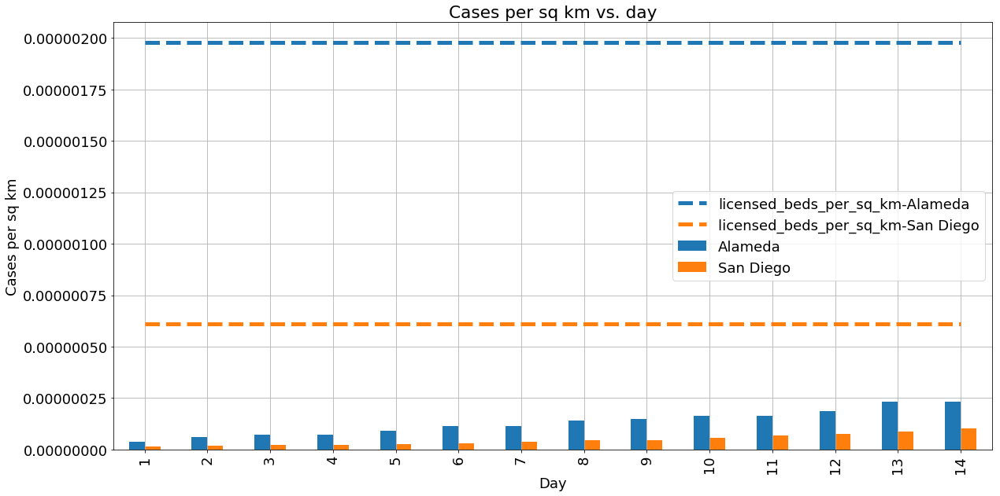

In [38]:
cases_per_sq_km("County", ["San Diego", "Alameda"])

### Plot 5: Visualize Hospital utilization rate by County at various `hospital_rate`

The following visualization shows the high hospital utilization rates by counties.

In [39]:
def plot_hospital_capacity(hospital_rate, date, min_vis=0.1):
    """
    Choropleth visualization to view hospital utilization rate by county for a particular date at various 
    hospitalization rates
    
    Input
    -----
    hospital_rate: float
        Value between 0.0 to 1.0 to indicate how many of confirmed cases will require hospitalization 
    date: pandas datetime
        date in an acceptable pandas format. Visualization will be increase of infected percentage population
        of a county
    min_vis: float
        minimum required percentage increase to show on plot
        default: 0.1
    """
    filtered = enigma_hospital_bed[
        enigma_hospital_bed["date"] == date
    ][["fips", "confirmed", "num_licensed_beds"]]
    
    filtered["bed_util"] = hospital_rate*filtered["confirmed"]/filtered["num_licensed_beds"] * 100
    filtered = filtered[filtered["bed_util"] > min_vis * 100]
    
    fig = px.choropleth(
        filtered[["fips", "bed_util"]], 
        geojson=counties, locations="fips", color="bed_util",
        color_continuous_scale="Viridis",
        range_color=(0, 100),
        scope="usa",
        labels={"bed_util":"Percent Bed Utilization"}

    )
    fig.update_layout(
        title=f"Hospital Utilization Rate on {str(date.date())} with {hospital_rate*100}% cases hospitalized"
    )
    fig.show()

In [40]:
plot_hospital_capacity(0.2, pd.to_datetime("04-02-2020"), min_vis=0.05)

# Get data from AWS Data Exchange

The AWS Data Exchange (ADX) is a data marketplace where vendors make their data sets publicly available. In this section, we will bring the [Foursquare COVID-19 Foot Traffic data](https://aws.amazon.com/marketplace/pp/prodview-cjhkgxpn6vcce?qid=1585602123030&sr=0-7&ref_=srh_res_product_title).

For this section, we have subscribed to the data set and received a data set ID and a revision ID, and created an S3 bucket. Subscribing to the data set and creating an S3 bucket is required to download and visualize the data.

This code pulls a specific revision of the data from ADX to the S3 bucket defined below. The revision IDs may change as providers update data.


### Data Description

The Foursquare foot traffic data is a daily, percentage data set that demonstrates how foot traffic to various venues (Airports, Gyms, Grocery Stores, etc.) have changed since since February 19, 2020 in various metro areas.

In [41]:
data_set_id = <DATA_SET_ID> # this won"t change
revision_id = <REVISION_ID> # this can change
destination_bucket = <BUCKET>

dataexchange = boto3.client(service_name="dataexchange", region_name="us-east-2")

revision_assets = dataexchange.list_revision_assets(DataSetId=data_set_id, RevisionId=revision_id)
asset_id = revision_assets["Assets"][0]["Id"]

export_job = dataexchange.create_job(
                Type="EXPORT_ASSETS_TO_S3",
                Details={
                    "ExportAssetsToS3": {
                        "DataSetId": data_set_id,
                        "RevisionId": revision_id,
                        "AssetDestinations": 
                            [{ "AssetId": asset_id,"Bucket": destination_bucket, "Key":"test-covid-obj.csv" }]
                    }
                }    
            )

dataexchange.start_job(JobId=export_job['Id'])


{'ResponseMetadata': {'RequestId': '4754ff63-6920-46ba-bd6c-1b92c41a9836',
  'HTTPStatusCode': 202,
  'HTTPHeaders': {'content-type': 'application/json',
   'content-length': '0',
   'connection': 'keep-alive',
   'date': 'Mon, 06 Apr 2020 18:39:59 GMT',
   'x-amzn-requestid': '4754ff63-6920-46ba-bd6c-1b92c41a9836',
   'x-amz-apigw-id': 'Kk-b2H8XCYcFYDg=',
   'x-amzn-trace-id': 'Root=1-5e8b777e-792988d04deffcd8ab64a980',
   'x-cache': 'Miss from cloudfront',
   'via': '1.1 cbadf786e73e9206869faf7515a0ce4f.cloudfront.net (CloudFront)',
   'x-amz-cf-pop': 'YTO50-C2',
   'x-amz-cf-id': 'C1TEhlSMMRDqJVp0wUbjSyLzEk0-cnzAL3bc3hV198iimFX6HgzyUQ=='},
  'RetryAttempts': 0}}

#### We use the AWS CLI to download the data from S3 to our local volume.

In [43]:
# uncomment the following line to and fill in with a local bucket to 
# use the AWS CLI to transfer the Foursquare data from S3 to the local volume
# !aws s3 cp "s3://{destination_bucket}/test-covid-obj.csv" /home/ec2-user/SageMaker/

#### This data set is an excel file, so we must use `pd.ExcelFile()` and `pd.read_excel()`

In [44]:
df = pd.ExcelFile("test-covid-obj.csv")
print(df.sheet_names)

['Airports', 'Auto Dealerships', 'Banks', 'Bars', 'Big Box Stores', 'Casual Dining Chains', 'Clothing Stores', 'Convenience Store', 'Drugstores', 'Fast Food', 'Gas Stations', 'Grocery Stores', 'Gyms', 'Hardware Stores', 'Hotels', 'Movie Theaters', 'Offices', 'Shopping Malls', 'Warehouse Stores']


This is a manually generated set of categories that segment each of the venues into buckets.

In [45]:
categories = {
    "travel": ["Airports", "Hotels", "Gas Stations", "Auto Dealerships"],
    "shopping": [
        "Big Box Stores", "Casual Dining Chains", "Clothing Stores", "Convenience Store",
        "Drugstores", "Grocery Stores", "Hardware Stores", "Shopping Malls", "Warehouse Stores"
    ],
    "entertainment_recreation": ["Bars", "Fast Food", "Gyms", "Movie Theaters"],
    "misc": ["Banks", "Offices"]
}

In [46]:
def fix_date(dataframe):
    cols = dataframe.columns
    date_col = cols[0]
    dataframe.index = pd.DatetimeIndex(dataframe[date_col]).rename("Date")
    dataframe = dataframe[cols[1:]] 
    return dataframe

In [47]:
def compare_locations(categs, geo):
    list_of_locs = []
    for category in categs:
        list_of_locs.extend(categories[category])
    
    dfs = [fix_date(pd.read_excel(df, sheet)) for sheet in list_of_locs]

    fig = plt.figure(figsize=(20,10))
    ax = fig.add_subplot(1,1,1)

    for i, d in enumerate(dfs):
        linestyle = "--" if list_of_locs[i] in categories["travel"] else "-"
        ax = d[geo].plot(ax=ax, label=list_of_locs[i], linewidth=5, linestyle=linestyle)    

    ax.set_xticks(dfs[0].index)
    ax.axvline(pd.to_datetime("2020-03-13"), linewidth=3, c='k', linestyle=':', label="National Emergency Declared")
    ax.axhline(100, linewidth=3, c='r', linestyle=':', label="Feb 19 baseline")
    ax.grid()
    ax.set_ylabel("Percent of people")
    ax.set_title(f"{geo} % Attendance over time to various venues")
    ax.legend(ncol=4)
    plt.show()

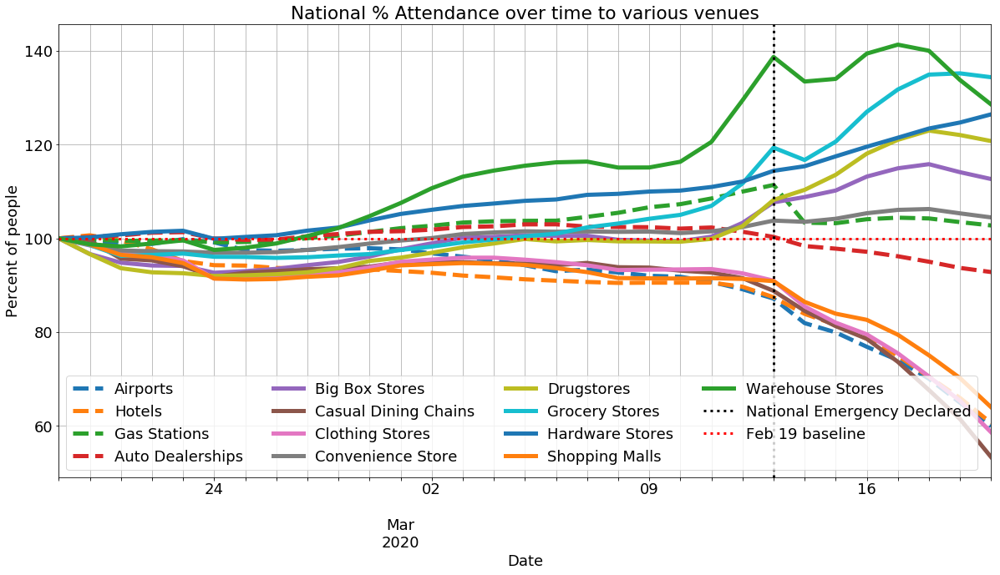

In [48]:
compare_locations(["travel", "shopping"], "National")

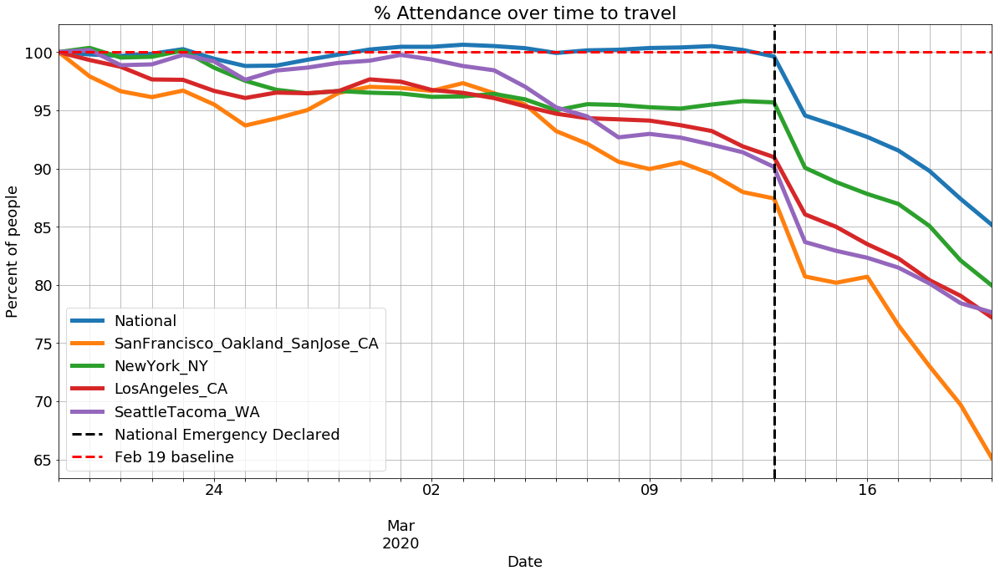

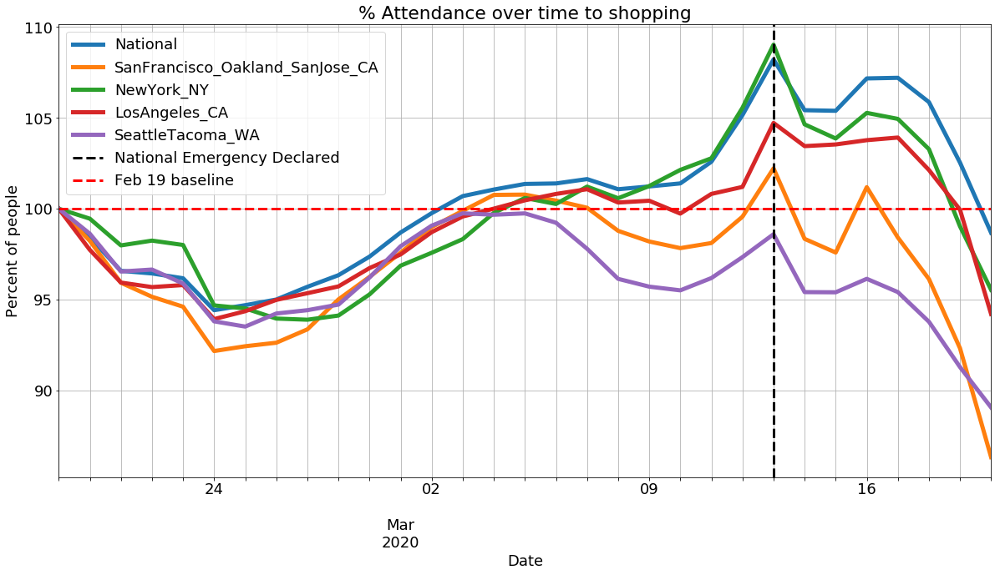

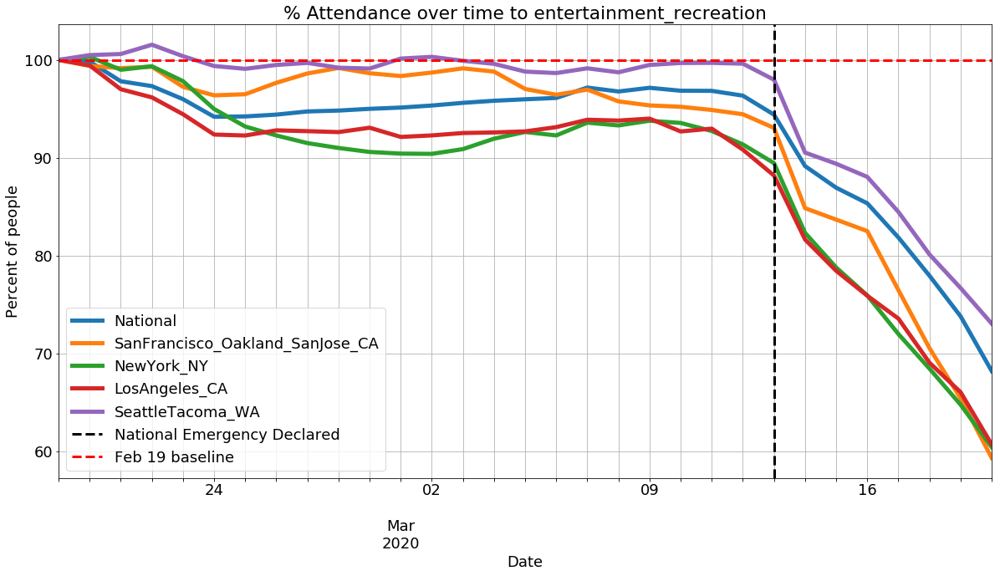

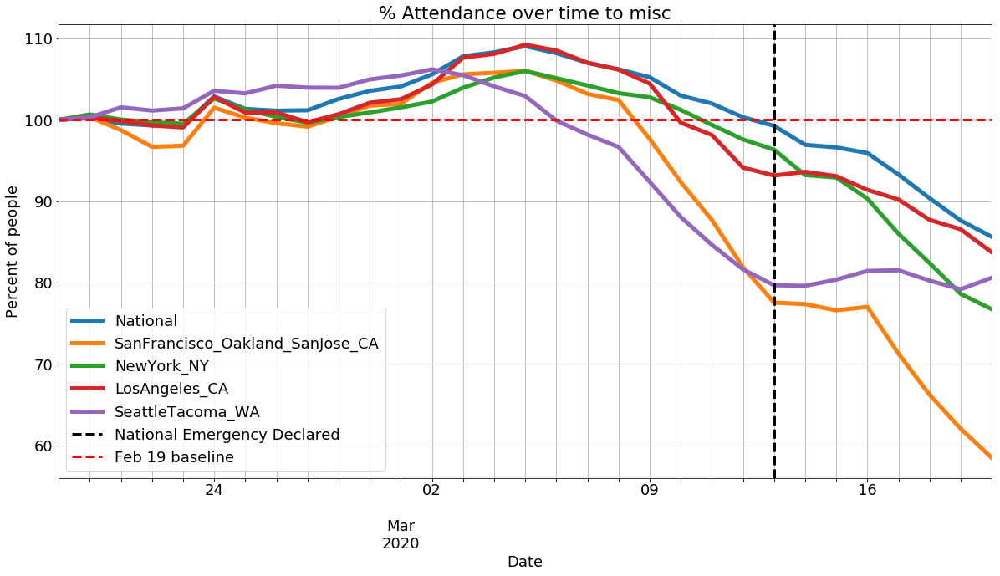

In [49]:
for category in categories:
    locations = categories[category]
    df_locs = [pd.read_excel(df, sheet) for sheet in locations]
    df_combined = pd.concat(df_locs)
    
    df_combined = fix_date(df_combined)
    df_avg = df_combined.groupby("Date").mean()
    
    fig = plt.figure(figsize=(20,10))
    ax = fig.add_subplot(1,1,1)
    ax = df_avg.plot(ax=ax, title=f"Percent of people going to {category} by date", linewidth=5)
    ax.axvline(pd.to_datetime("2020-03-13"), linewidth=3, c='k', linestyle='--', label="National Emergency Declared")
    ax.axhline(100, linewidth=3, c='r', linestyle='--', label="Feb 19 baseline")
    ax.set_ylabel("Percent of people")
    ax.set_xticks(df_avg.index)
    ax.legend()
    ax.set_title(f"% Attendance over time to {category}")
    ax.grid()


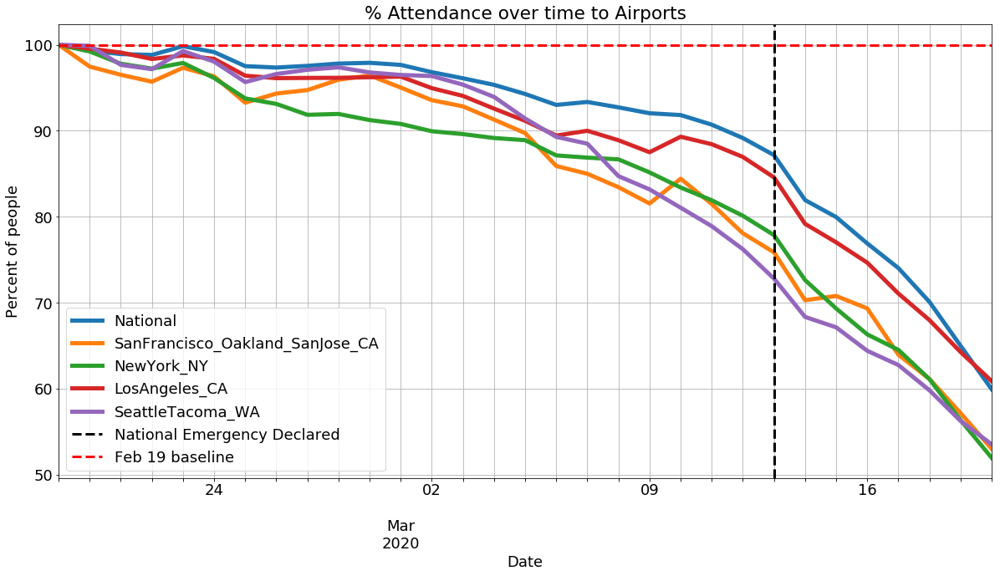

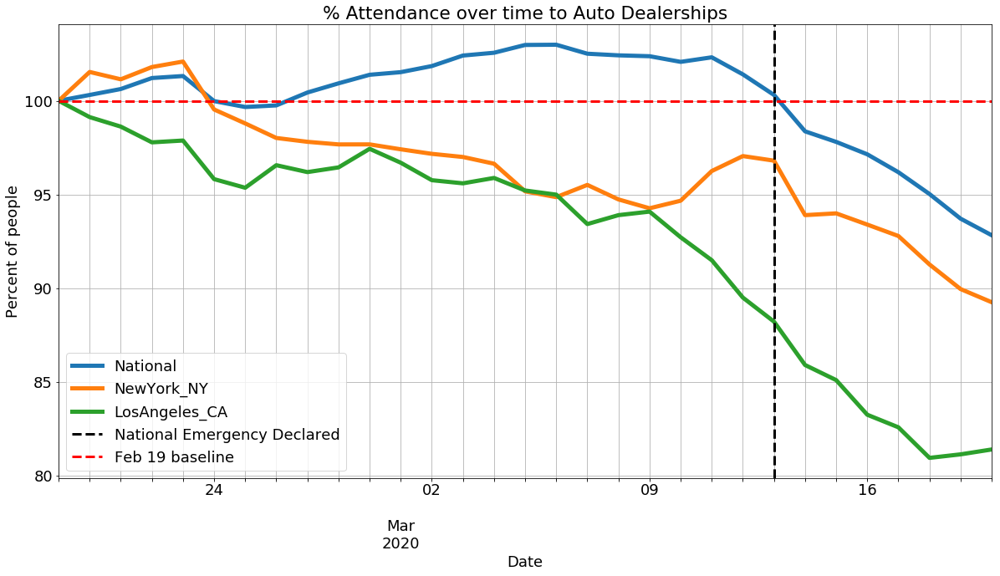

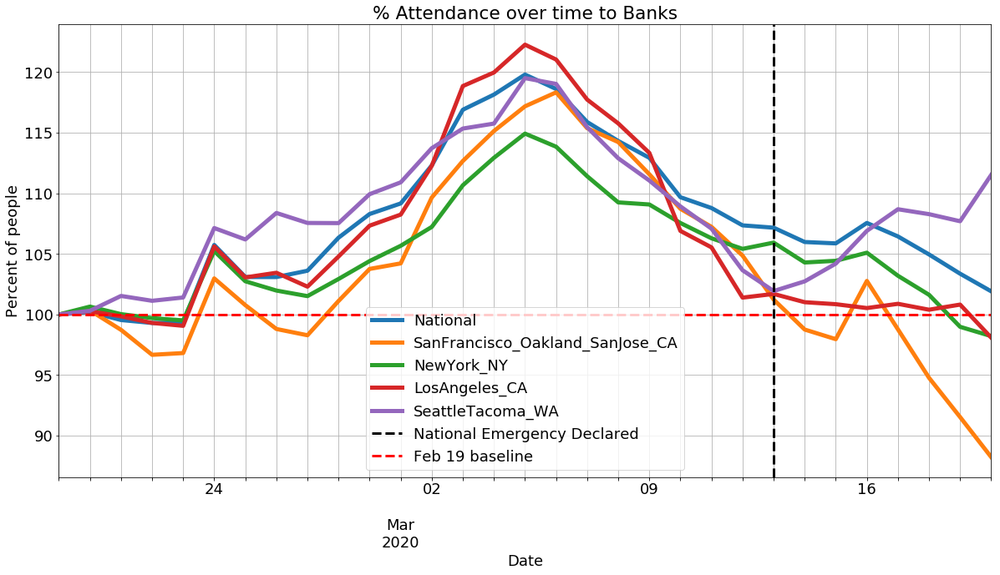

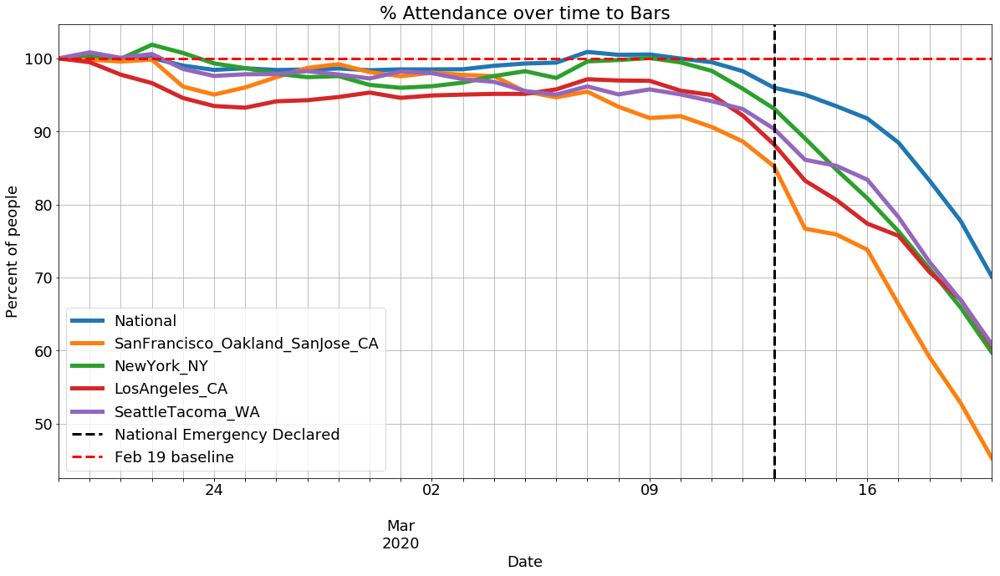

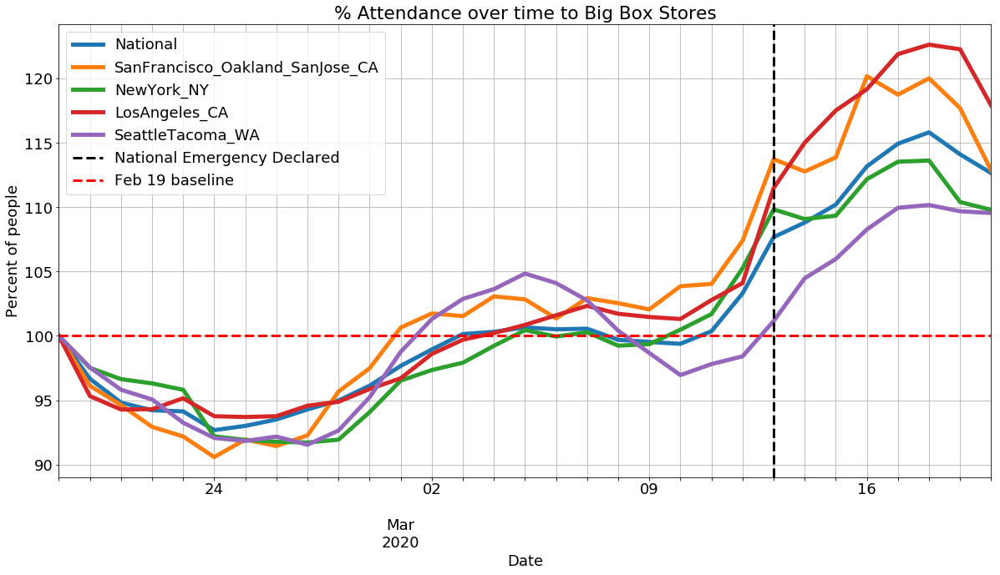

...

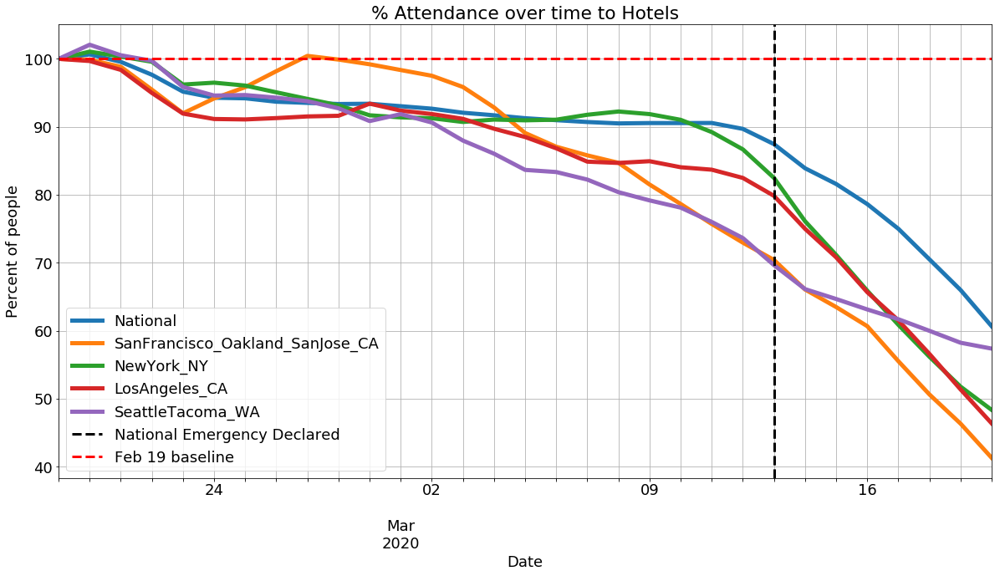

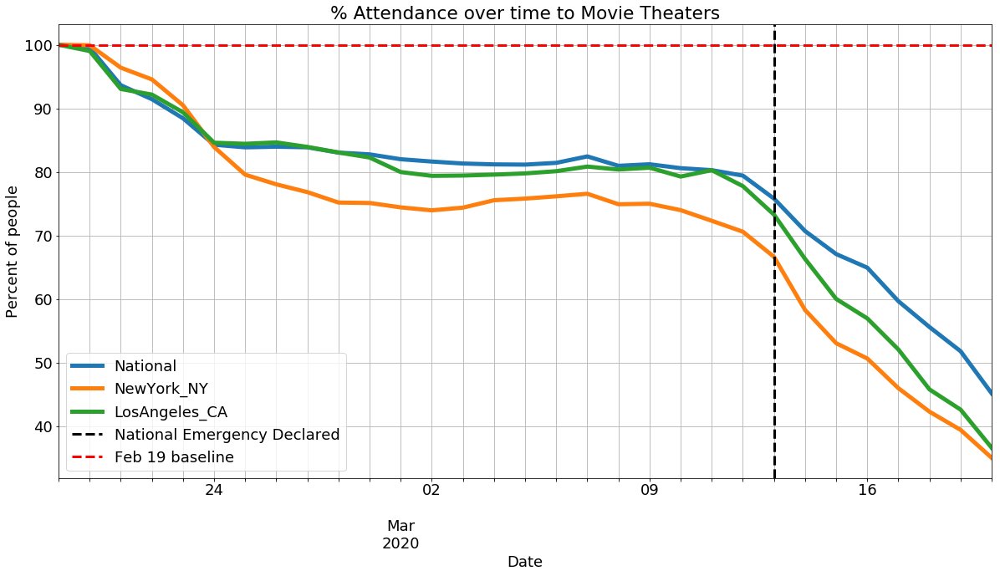

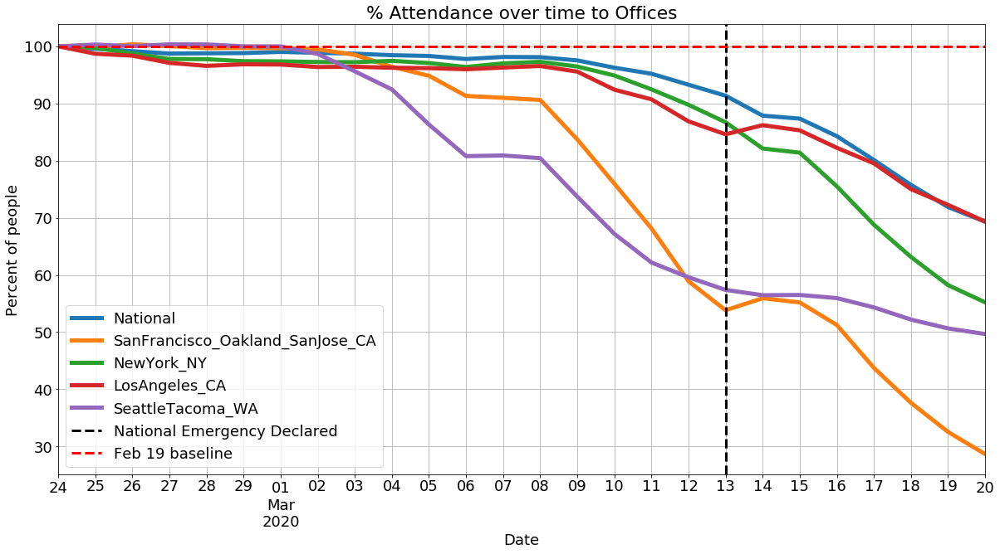

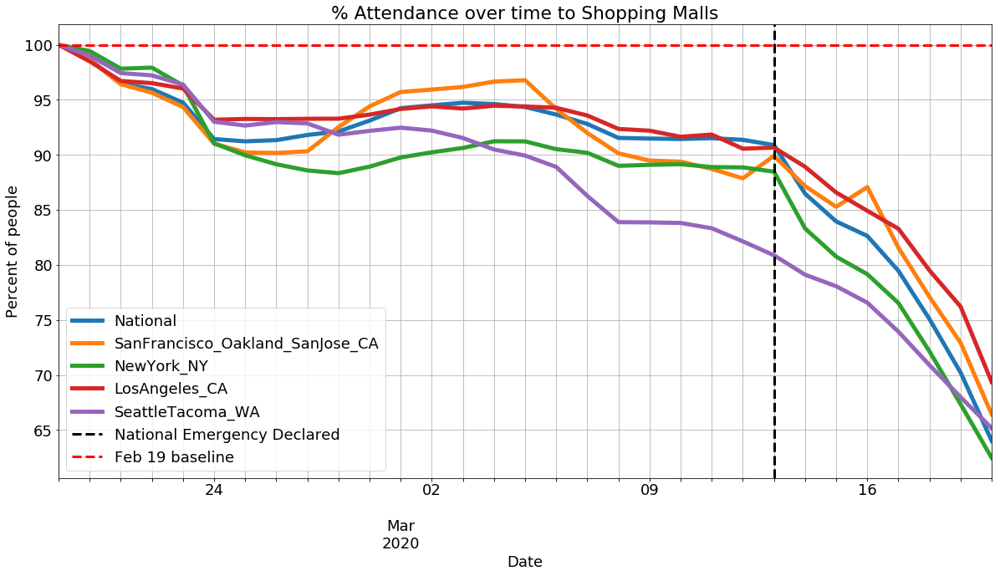

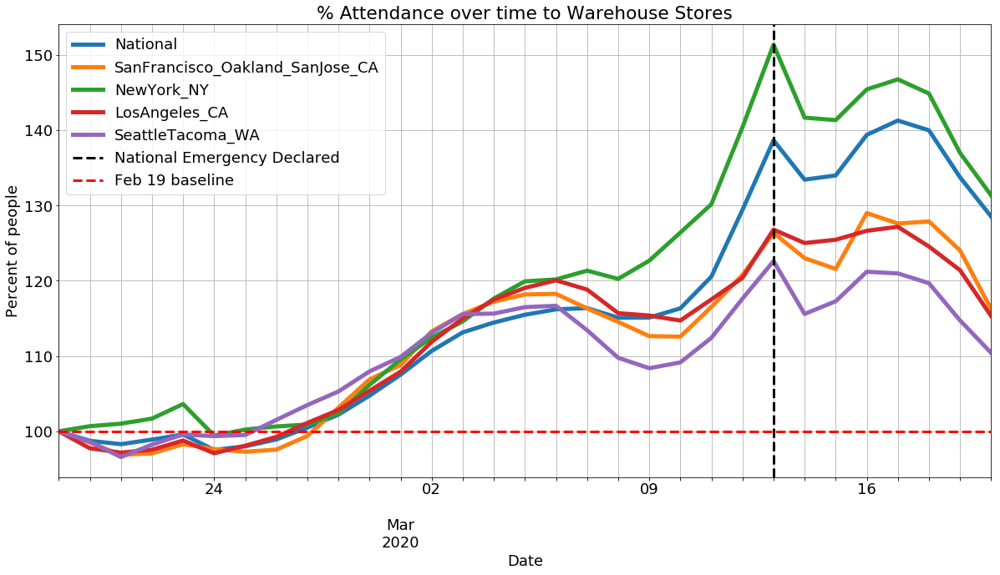

In [50]:
cols = {}
for sheet in df.sheet_names:
    df_sheet = pd.read_excel(df, sheet)
    
    df_sheet = fix_date(df_sheet)
    
    fig = plt.figure(figsize=(20,10))
    ax = fig.add_subplot(1,1,1)
    ax = df_sheet.plot(ax=ax, title=f"Percent of people going to {sheet} by date", linewidth=5)
    ax.axvline(pd.to_datetime("2020-03-13"), linewidth=3, c='k', linestyle='--', label="National Emergency Declared")
    ax.axhline(100, linewidth=3, c='r', linestyle='--', label="Feb 19 baseline")
    ax.set_ylabel("Percent of people")
    ax.set_xticks(df_sheet.index)
    ax.legend()
    ax.set_title(f"% Attendance over time to {sheet}")
    ax.grid()

# Publish Data 

### Save data back to S3 and create new database table

After performing various data transformations, we may want to share your results with our colleagues. `awswrangler` makes this easy by allowing us to publish this data back into our Glue catalog using `awswrangler.pandas.to_parquet()`

In [ ]:
to_save = enigma_hospital_bed.drop(["Id2"], axis=1)

wr.pandas.to_parquet(
    dataframe=to_save,
    database="covid-19",
    path=f"s3://{destination_bucket}/daily_county_cases_agg",
)

### Read saved data with AWS Data Wrangler

Reading this data back into a Jupyter notebook is the same as before, with `awswrangler.pandas.read_sql_athena()`

In [52]:
from_athena = wr.pandas.read_sql_athena(
    sql="select * from daily_county_cases_agg",
    database="covid-19"
)

In [53]:
from_athena.sample(5)

,fips,date,confirmed,deaths,recovered,active,day,id,county,state,population2018,pc_pop_infected,increase_pc_pop_infected,num_licensed_beds,num_staffed_beds,num_icu_beds,__index_level_0__
54223,22023,2020-03-25,0,0,0,0,4,0500000US22023,Cameron Parish,Louisiana,6968,0.000000,0.000000,49,49,0,9319
16880,02220,2020-03-27,0,0,0,0,6,0500000US02220,Sitka City and Borough,Alaska,8647,0.000000,0.000000,27,25,0,973
69093,41015,2020-03-22,0,0,0,0,1,0500000US41015,Curry,Oregon,22813,0.000000,-0.000042,24,16,0,22912
137920,48117,2020-03-28,2,0,0,0,7,0500000US48117,Deaf Smith,Texas,18760,0.000107,0.000000,42,30,0,21936
6478,40079,2020-03-29,1,0,0,0,8,0500000US40079,Le Flore,Oklahoma,49980,0.000020,0.000000,43,25,4,22386
